In [2]:
import NeuroAnalysisTools
import NeuroAnalysisTools.core.FileTools as ft
import NeuroAnalysisTools.RetinotopicMapping as rm
import pickle
import numpy as np
import pandas as pd
import os
from tifffile import imread, imwrite
import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter
import cv2
from sklearn.decomposition import PCA
from sklearn import metrics
from sklearn.mixture import GaussianMixture
from sklearn.cluster import KMeans
from scipy.ndimage import gaussian_filter, median_filter
import timeit
from glob import glob
from NatMovie_utils import *


In [3]:
os.environ['CUDA_VISIBLE_DEVICES'] = '3'
import cupy as cp

In [4]:
path_wfield =r'/home/lzx/data/WF_VC_liuzhaoxi/24.05.20_H78/natural-movie/process/20240520-180021-wfield'

experiment = os.path.basename(path_wfield)[:15]
rawPath = pjoin(path_wfield, '../../raw')
path_out = pjoin(path_wfield, '..', experiment + '-baseline')
os.makedirs(path_out, exist_ok=True)
trialfile = pd.read_csv(pjoin(path_wfield, 'trials.csv'), header=None).values.astype(int)
movie_folder = pjoin(rawPath, 'natural_movies')
movie_list = pd.read_csv(pjoin(movie_folder, 'movie_list.txt'), header=None).values
n_movie = movie_list.size
movie_name_list = []
for imovie in range(n_movie):
    movie_name_list.append(str(movie_list[imovie])[2:-6])

n_frame = 150  # 帧


In [ ]:
# path_retinotopy = r'/home/lzx/data/WF_VC_liuzhaoxi/P73/20240718/retinotopy/process/20240718-161348-retinotopy'
# 
# with open(pjoin(path_retinotopy, 'retinotopy_out.pkl'), 'rb') as f:
#     retino = pickle.load(f)
# f.close()
# n_patch = len(retino['finalPatchesMarked'])


In [81]:
U = np.load(pjoin(path_wfield, 'U.npy')).astype('float32')
SVT = np.load(pjoin(path_wfield, 'SVT.npy')).astype('float32')
frames_average = np.load(pjoin(path_wfield, 'frames_average.npy')).astype('float32')[0]

SVT_470 = SVT[:,::2]
SVT_405 = SVT[:,1::2]
SVTcorr = SVT_470-SVT_405

In [12]:
tif = imread(pjoin(path_wfield, experiment+'-merged.tif'))
# frames_average = np.load(pjoin(path_wfield, 'frames_average.npy')).astype('float32')
# from wfield import *
# tif = mmap_dat(glob(pjoin(path_wfield, "*.bin"))[0])
tif.shape

(12019, 2, 380, 450)

In [62]:

frames_average = np.mean(tif[:50], axis=0)
tif470 = (tif[:,0]-frames_average[0])/frames_average[0]
tif405 = (tif[:,1]-frames_average[1])/frames_average[1]

tif_corr=tif470-tif405
tif_height,tif_width=tif_corr.shape[1:]

In [63]:
n_frame = 10*5*60
tif_corr = tif_corr[:n_frame]

In [7]:
def Gsorting_NatMov(SVT, trials_onset, n_movie, movie_len, pre_length=0, after_length=0):
    # SVT: [ncomponent, n_frame]
    nSVD = SVT.shape[0]
    n_trials = trials_onset.size
    n_rep = n_trials // n_movie

    SVT_sorted = cp.empty((nSVD, movie_len + pre_length + after_length, n_movie, n_rep))
    for i_trial in range(n_trials):
        i_movie = i_trial // n_rep
        i_rep = i_trial % n_rep
        SVT_sorted[:nSVD, :movie_len + pre_length + after_length, i_movie, i_rep] = SVT[:,
                                                                                  trials_onset[i_trial] - pre_length:
                                                                                  trials_onset[
                                                                                      i_trial] + movie_len + after_length]

    return SVT_sorted

In [20]:
pre_length = 20
after_lenth = 30
# SVTcorr_sort维度：[nSVD, n_frame, n_movie, n_rep]

tiff_sort = Gsorting_NatMov(tif_corr.reshape(-1,tif_height*tif_width).T, trialfile[:, 1], n_movie, n_frame, pre_length, after_lenth).astype('float32')
tiff_sort = tiff_sort.reshape(tif_height,tif_width,*tiff_sort.shape[1:])
n_rep = tiff_sort.shape[-1]
print('tiff_sort.shape: (height, width, n_frame, n_movie, n_rep) ', tiff_sort.shape)


tiff_sort.shape: (height, width, n_frame, n_movie, n_rep)  (512, 512, 200, 14, 5)


In [17]:
U = np.load(pjoin(path_wfield, 'U.npy')).astype('float32')
SVTcorr = np.load(pjoin(path_wfield, 'SVTcorr.npy')).astype('float32')
frames_average = np.load(pjoin(path_wfield, 'frames_average.npy')).astype('float32')
tif_height,tif_width=U.shape[:-1]

In [6]:
from wfield import *

lmarks = load_allen_landmarks(pjoin(path_wfield, 'dorsal_cortex_landmarks.json'))
ccf_regions_reference, proj, brain_outline = allen_load_reference('dorsal_cortex')
# this loads the untransformed atlas
atlas_im, areanames, brain_mask = atlas_from_landmarks_file(pjoin(path_wfield, 'dorsal_cortex_landmarks.json'),
                                                            do_transform=True)
# this converts the reference to image space (unwarped)
ccf_regions_im = allen_transform_regions(lmarks['transform'], ccf_regions_reference,
                                         resolution=lmarks['resolution'],
                                         bregma_offset=lmarks['bregma_offset'])



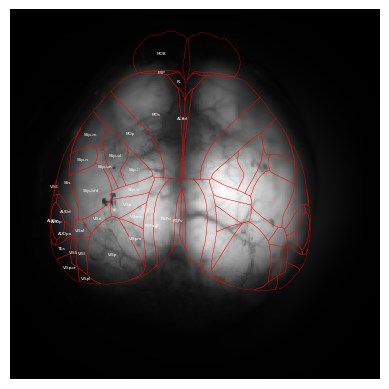

In [9]:
# merge_frame_size = (512, 512)  # (width, height)
# fig = plt.figure(figsize=(merge_frame_size[0] / 128, merge_frame_size[1] / 128), dpi=128)
fig = plt.figure()
plt.imshow(frames_average[0], cmap='gray')
for i, r in ccf_regions_im.iterrows():
    plt.plot(r['left_x'], r['left_y'], 'r', lw=0.2)
    plt.plot(r['right_x'], r['right_y'], 'r', lw=0.2)
    plt.text(r.left_center[0], r.left_center[1], r.acronym, color='w', va='center', fontsize=3, alpha=1, ha='center')

plt.axis('off')
fig.set_facecolor('white')
plt.savefig(pjoin(path_out, 'ccf.png'), bbox_inches='tight', pad_inches=0)
plt.show()


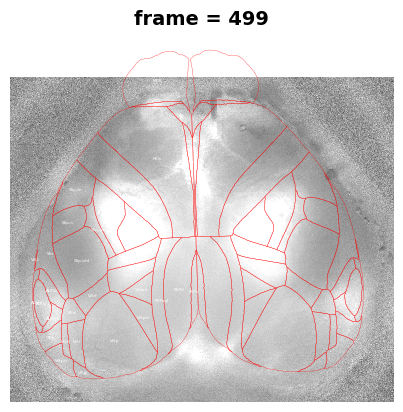

In [176]:
from IPython.display import clear_output

for i_frame in range(480, 500):
    # 设置颜色映射的范围为矩阵绝对值的最大最小值
    vmin, vmax = -0.3, 0.3
    # 使用Matplotlib绘制矩阵，根据绝对值设置颜色亮度
    # plt.matshow(flashing_square[:,:,i], cmap='gray', vmin=vmin, vmax=vmax)  
    # plt.imshow(flashing_square[:,:,i])
    plt.imshow(tif_corr[i_frame], cmap='gray', vmin=vmin, vmax=vmax)
    for i, r in ccf_regions_im.iterrows():
        plt.plot(r['left_x'], r['left_y'], 'r', lw=0.2)
        plt.plot(r['right_x'], r['right_y'], 'r', lw=0.2)
        plt.text(r.left_center[0], r.left_center[1], r.acronym, color='w', va='center', fontsize=3, alpha=1, ha='center')

    plt.axis('off')
    fig.set_facecolor('white')
    plt.title(f'frame = {i_frame}')
    plt.show()
    plt.pause(0.01)
    clear_output(wait=True)

In [ ]:
# from scipy.ndimage import median_filter
from cupyx.scipy.ndimage import median_filter, gaussian_filter, uniform_filter
tif_corr1=cp.asarray(tif_corr)
# 定义二维滤波器大小
filter_size = (1, 3, 3)  
# 对视频矩阵进行中值滤波
tif_corr_filt1_uni = uniform_filter(tif_corr1, size=filter_size)
tif_corr_filt1_med = median_filter(tif_corr1, size=filter_size)

tif_corr_filt_uni = cp.asnumpy(tif_corr_filt1_uni)
tif_corr_filt_med = cp.asnumpy(tif_corr_filt1_med)

del tif_corr1, tif_corr_filt1_uni, tif_corr_filt1_med
cp._default_memory_pool.free_all_blocks()

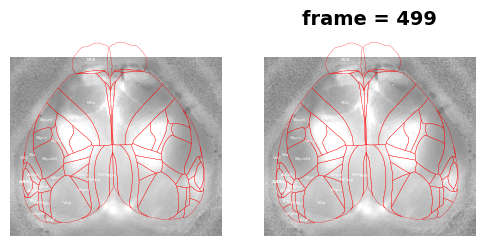

In [179]:

for i_frame in range(480, 500):
    # 设置颜色映射的范围为矩阵绝对值的最大最小值
    vmin, vmax = -0.3, 0.3
    # 使用Matplotlib绘制矩阵，根据绝对值设置颜色亮度
    # plt.matshow(flashing_square[:,:,i], cmap='gray', vmin=vmin, vmax=vmax)  
    # plt.imshow(flashing_square[:,:,i])
    fig, ax = plt.subplots(1, 2, figsize=(6, 12))
    ax[0].imshow(tif_corr_filt_uni[i_frame], cmap='gray', vmin=vmin, vmax=vmax)
    for i, r in ccf_regions_im.iterrows():
        ax[0].plot(r['left_x'], r['left_y'], 'r', lw=0.2)
        ax[0].plot(r['right_x'], r['right_y'], 'r', lw=0.2)
        ax[0].text(r.left_center[0], r.left_center[1], r.acronym, color='w', va='center', fontsize=3, alpha=1, ha='center')
    ax[1].imshow(tif_corr_filt_med[i_frame], cmap='gray', vmin=vmin, vmax=vmax)
    for i, r in ccf_regions_im.iterrows():
        ax[1].plot(r['left_x'], r['left_y'], 'r', lw=0.2)
        ax[1].plot(r['right_x'], r['right_y'], 'r', lw=0.2)
        ax[1].text(r.left_center[0], r.left_center[1], r.acronym, color='w', va='center', fontsize=3, alpha=1, ha='center')
    ax[0].axis('off')
    ax[1].axis('off')
    fig.set_facecolor('white')
    plt.title(f'frame = {i_frame}')
    plt.show()
    plt.pause(0.01)
    clear_output(wait=True)

In [12]:
pre_length = 20
after_lenth = 30
# SVTcorr_sort维度：[nSVD, n_frame, n_movie, n_rep]
SVTcorr_sort = sorting_NatMov(SVTcorr, trialfile[:, 1], n_movie, n_frame, pre_length, after_lenth).astype('float32')
print('SVTcorr_sort.shape: (nSVD, n_frame, n_movie, n_rep) ', SVTcorr_sort.shape)
n_rep = SVTcorr_sort.shape[-1]
SVTcorr_mean = np.mean(SVTcorr_sort, axis=3)

SVTcorr_sort.shape: (nSVD, n_frame, n_movie, n_rep)  (200, 200, 14, 5)


In [14]:
tif_sort = np.tensordot(U, SVTcorr_sort, axes=(2, 0)).astype('float32')
tif_sort.shape
# tif_sort维度：[width, height, n_frame, n_movie, n_rep]

(512, 512, 200, 14, 5)

In [18]:
tiff_sort_flat= tif_sort.reshape(tif_height*tif_width,-1)
tiff_sort_flat.shape
# tiff_sort_flat1 = tif_corr.reshape(-1, tif_height*tif_width).T
# tiff_sort_flat1.shape

(262144, 14000)

In [29]:
tiff_sort_flat=cp.asnumpy(tiff_sort_flat1)
del tiff_sort_flat1
cp._default_memory_pool.free_all_blocks()

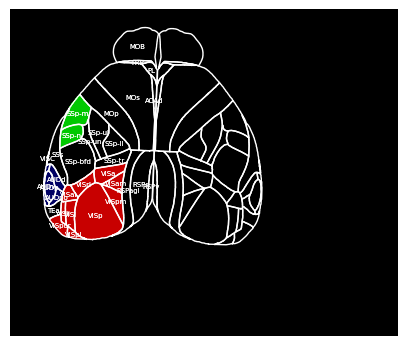

In [46]:
# Plot the overlap for the same region in the warped versus unwarped atlases 
bg = 0
aud=range(20,24)
# aud=[21]
soma = [5,6]
visual = range(24,34)

plt.figure(figsize = [5,5])
reg = np.zeros([*atlas_im.shape,3])
reg[:, :, 0] = np.isin(atlas_im, visual) * 200
reg[:, :, 1] = np.isin(atlas_im, soma) * 200
reg[:, :, 2] = np.isin(atlas_im, aud) * 100
plt.imshow(reg.astype('uint8'))

for i,r in ccf_regions_im.iterrows():
    for side in ['left', 'right']:
        plt.plot(np.array(r[side+'_x']),r[side +'_y'],'w',lw=1)
        plt.text(r.left_center[0], r.left_center[1], str(i+1)+'-'+r.acronym, color='w', va='center', fontsize=5, alpha=1, ha='center')
plt.axis('off')
plt.savefig('/home/lzx/data/WF_VC_liuzhaoxi/______________natural_movie_summary/brain areas.png')
plt.show()

In [22]:
def flat_mask(Uflat,xy):
    # index are in xy, like what np.where(mask) returns
    x = np.array(np.clip(xy[0],0,tif_height-1),dtype=int)
    y = np.array(np.clip(xy[1],0,tif_width-1),dtype=int)
    idx = np.ravel_multi_index((x,y),(tif_height,tif_width))
    t = Uflat[idx,:]
    return t

# visual_timecourse = flat_mask(tiff_sort_flat1,np.where(np.isin(atlas_im, visual))).reshape(*tif_corr.shape[1:] ,-1).mean(axis=0)
# soma_timecourse = flat_mask(tiff_sort_flat1,np.where(np.isin(atlas_im, soma))).reshape(*tif_corr.shape[1:] ,-1).mean(axis=0)
# bg_timecourse = flat_mask(tiff_sort_flat1,np.where(np.isin(atlas_im, bg))).reshape(*tif_corr.shape[1:] ,-1).mean(axis=0)
visual_timecourse = flat_mask(tiff_sort_flat,np.where(np.isin(atlas_im, visual))).reshape(-1, *SVTcorr_sort.shape[1:])
soma_timecourse = flat_mask(tiff_sort_flat,np.where(np.isin(atlas_im, soma))).reshape(-1, *SVTcorr_sort.shape[1:])
aud_timecourse = flat_mask(tiff_sort_flat,np.where(np.isin(atlas_im, aud))).reshape(-1, *SVTcorr_sort.shape[1:])
print('visual timecourse:',visual_timecourse.shape)
print('soma timecourse:',soma_timecourse .shape)
print('aud timecourse:', aud_timecourse.shape)

visual timecourse: (11246, 200, 14, 5)
soma timecourse: (2528, 200, 14, 5)
aud timecourse: (1991, 200, 14, 5)


In [27]:
area_timecourse= np.stack((visual_timecourse.mean(axis=0).transpose(1,0,2), 
                           aud_timecourse.mean(axis=0).transpose(1,0,2), 
                           soma_timecourse.mean(axis=0).transpose(1,0,2)), 
                           axis=0)
area_timecourse.shape

(3, 14, 200, 5)

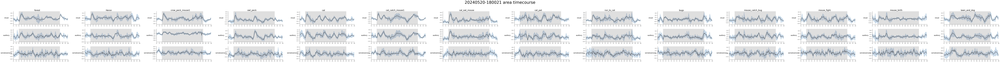

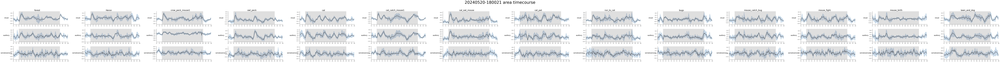

In [29]:
subplot_timecourse(area_timecourse, patch_list=['visual', 'auditory', 'somatosensory'], 
                   movie_name_list=movie_name_list, title=f'{experiment} area timecourse', 
                   outpath=path_out, pre_length=20, n_frame=150, plot_rep=False, dpi=200)
subplot_timecourse(area_timecourse, patch_list=['visual', 'auditory', 'somatosensory'], 
                   movie_name_list=movie_name_list, title=f'{experiment} area timecourse', 
                   outpath='/home/lzx/data/WF_VC_liuzhaoxi/______________natural_movie_summary/area_timecourse', 
                   pre_length=20, n_frame=150, plot_rep=False, dpi=200)

In [32]:
VA_timecourse=np.empty((10, *SVTcorr_sort.shape[1:]))
for i, i_area in enumerate(range(24,34)):
    VA_timecourse[i]=flat_mask(tiff_sort_flat,np.where(np.isin(atlas_im, i_area))).reshape(-1, *SVTcorr_sort.shape[1:]).mean(axis=0)
VA_timecourse.shape

(10, 200, 14, 5)

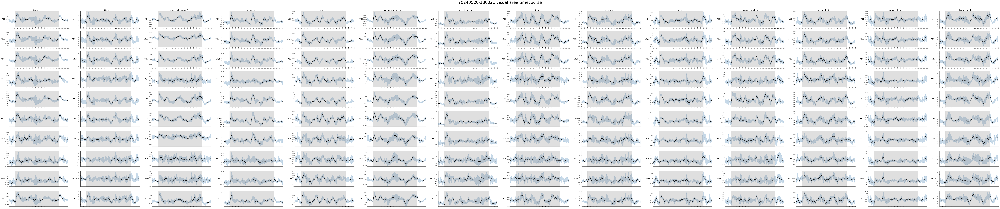

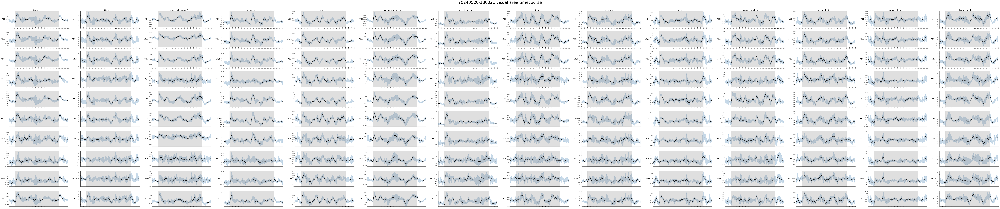

In [35]:
VA_list=['VISli','VISpor','VISpl','VISpm','VISl','VISal','VISrl', 'VISa', 'VISam', 'V1']
subplot_timecourse(VA_timecourse.transpose(0, 2, 1, 3), patch_list=VA_list, 
                   movie_name_list=movie_name_list, title=f'{experiment} visual area timecourse', 
                   outpath=path_out, pre_length=20, n_frame=150, plot_rep=False, dpi=200)
subplot_timecourse(VA_timecourse.transpose(0, 2, 1, 3), patch_list=VA_list, 
                   movie_name_list=movie_name_list, title=f'{experiment} visual area timecourse', 
                   outpath='/home/lzx/data/WF_VC_liuzhaoxi/______________natural_movie_summary/visual_area_timecourse', 
                   pre_length=20, n_frame=150, plot_rep=False, dpi=200)

In [194]:
### spectral analysis (welch method)

from scipy.signal import welch
fs = 10  # Sampling frequency in Hz
# freq_vis, psd_vis = welch(visual_timecourse.mean(axis=0), fs, nperseg=n_frame)
# freq_som, psd_som = welch(soma_timecourse.mean(axis=0), fs, nperseg=n_frame)
# freq_bg, psd_bg = welch(bg_timecourse.mean(axis=0), fs, nperseg=n_frame)
freq_vis, psd_vis = welch(tif_corr[:,310,130], fs, nperseg=n_frame)
freq_som, psd_som = welch(tif_corr[:,135,85], fs, nperseg=n_frame)
freq_bg, psd_bg = welch(tif_corr[:,60,50], fs, nperseg=n_frame)


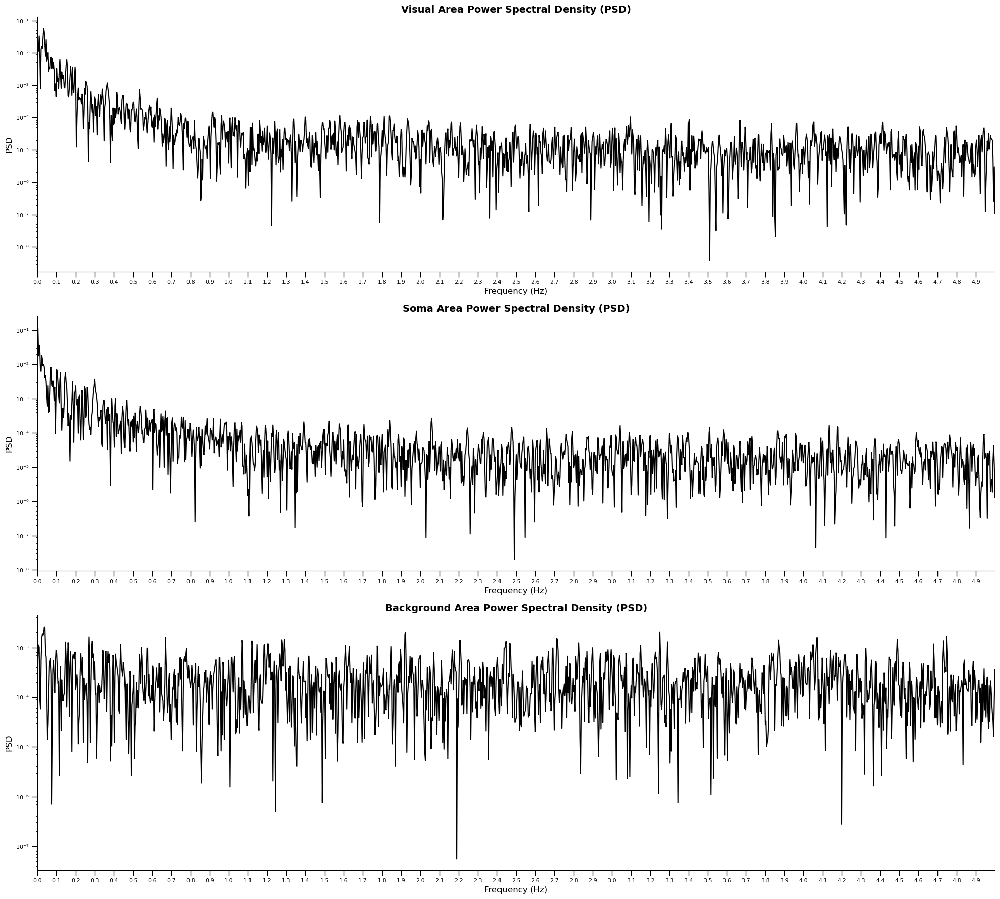

In [198]:

fig = plt.figure(figsize=(20, 18))

# Visual Area
axis_vis = fig.add_subplot(3, 1, 1)
axis_vis.semilogy(freq_vis, psd_vis)
# axis_vis.plot(freq_vis, psd_vis)
axis_vis.set_title('Visual Area Power Spectral Density (PSD)')
axis_vis.set_xlabel('Frequency (Hz)')
axis_vis.set_ylabel('PSD')
axis_vis.set_xlim([0, 5])
axis_vis.set_xticks(np.arange(0, 5, 0.1))

# Soma Area
axis_som = fig.add_subplot(3, 1, 2)
axis_som.semilogy(freq_som, psd_som)
# axis_som.plot(freq_som, psd_som)
axis_som.set_title('Soma Area Power Spectral Density (PSD)')
axis_som.set_xlabel('Frequency (Hz)')
axis_som.set_ylabel('PSD')
axis_som.set_xlim([0, 5])
axis_som.set_xticks(np.arange(0, 5, 0.1))

# Background Area
axis_bg = fig.add_subplot(3, 1, 3)
axis_bg.semilogy(freq_bg, psd_bg)
# axis_bg.plot(freq_bg, psd_bg)
axis_bg.set_title('Background Area Power Spectral Density (PSD)')
axis_bg.set_xlabel('Frequency (Hz)')
axis_bg.set_ylabel('PSD')
axis_bg.set_xlim([0, 5])
axis_bg.set_xticks(np.arange(0, 5, 0.1))

plt.tight_layout()
fig.set_facecolor('white')
# plt.savefig(pjoin(path_out,'pixel Spontaneous logPSD.png'))
# plt.savefig(pjoin(path_out,'pixel Spontaneous PSD.png'))
plt.show()
